In [20]:
import numpy as np
from scipy.integrate import odeint
import matplotlib.pyplot as plt
from scipy.optimize import minimize

import seaborn as sns

# Two state model

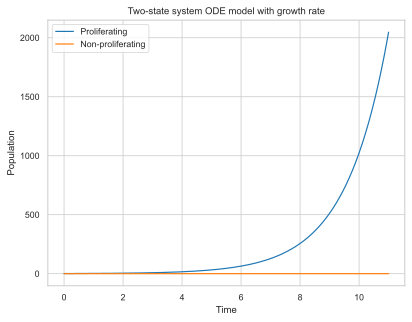

In [17]:


# Define the ODE model
def two_state_system(y, t, k1, k2, growth_rate):
    proliferating, non_proliferating = y
    
    dydt = [
        growth_rate * proliferating - k1 * proliferating + k2 * non_proliferating,  # Change in proliferating cells
        k1 * proliferating - k2 * non_proliferating   # Change in non-proliferating cells
    ]
    return dydt

# Parameters
k1 = 0.0  # Transition rate from proliferating to non-proliferating state
k2 = 0.0  # Transition rate from non-proliferating to proliferating state
growth_rate = 0.6931  # Growth rate of the proliferating population

# Initial conditions
y0 = [1, 0]  # Initial number of proliferating and non-proliferating cells

# Time vector
t = np.linspace(0, 11, 1000)  # Time points from 0 to 100 with 1000 points

# Solve the ODE
solution = odeint(two_state_system, y0, t, args=(k1, k2, growth_rate))

# Plot the results
plt.plot(t, solution[:, 0], label='Proliferating')
plt.plot(t, solution[:, 1], label='Non-proliferating')
plt.xlabel('Time')
plt.ylabel('Population')
plt.title('Two-state system ODE model with growth rate')
plt.legend()
plt.show()



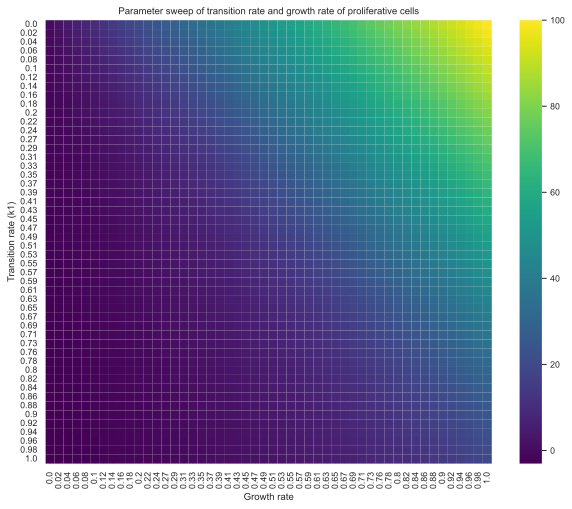

In [24]:
# Define the ODE model
def two_state_system(y, t, k1, k2, growth_rate):
    proliferating, non_proliferating = y
    
    dydt = [
        growth_rate * proliferating - k1 * proliferating + k2 * non_proliferating,  # Change in proliferating cells
        k1 * proliferating - k2 * non_proliferating   # Change in non-proliferating cells
    ]
    return dydt

# Initial conditions
y0 = [1, 0]  # Initial number of proliferating and non-proliferating cells

# Time vector
t = np.linspace(0, 100, 1000)  # Time points from 0 to 100 with 1000 points

# Parameter sweep
k1_values = np.linspace(0, 1, 50)  # Transition rate from proliferating to non-proliferating state
k2 = 0.05  # Transition rate from non-proliferating to proliferating state
growth_rate_values = np.linspace(0, 1, 50)  # Growth rate of the proliferating population

final_proliferating = np.zeros((len(k1_values), len(growth_rate_values)))

for i, k1 in enumerate(k1_values):
    for j, growth_rate in enumerate(growth_rate_values):
        solution = odeint(two_state_system, y0, t, args=(k1, k2, growth_rate))
        final_proliferating[i, j] = np.log(solution[-1, 0])  # Store the final number of proliferating cells

# Plot the results as a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(final_proliferating, cmap='viridis', xticklabels=np.round(growth_rate_values, 2),
            yticklabels=np.round(k1_values, 2))
plt.xlabel('Growth rate')
plt.ylabel('Transition rate (k1)')
plt.title('Parameter sweep of transition rate and growth rate of proliferative cells')
plt.show()


In [2]:
import numpy as np
import pandas as pd
import os as os
import matplotlib.pyplot as plt
import seaborn as sns


# Make plots look good 
%config InlineBackend.figure_format = 'svg'
sns.set_style("whitegrid")
sns.set_context("paper")

# Data 1

In [5]:
#put your path here
path_to_table = '/Users/raul/Box/Shared_Raul/Projects/Proliferative_Senesent/Data/RAR014/Colony_count_quantified/FinalTable/'

#Get all mask files
all_txt_files = list(filter(lambda x: x.endswith('.txt'), os.listdir(path_to_table)))
all_txt_files = sorted(all_txt_files)

# set up iniitial df
df = pd.read_csv(path_to_table+all_txt_files[0], sep=",")
df['ID'] = 1
df['Day'] = 8

print("Reading files:")
for i in range(1,len(all_txt_files)):
    
    if i < 4:
        day = 8
    elif i < 7:
        day = 2
    elif i < 11:
        day = 5
    elif i < 15:
        day = 11    
        
    df_hold = pd.read_csv(path_to_table+all_txt_files[i], sep=",")
    df_hold['ID'] = i+1
    df_hold['Day'] = day
    df = pd.concat([df,df_hold])
    
# Calculate any metric you want on the dataframe
df['Colony_area_per_number_of_cells'] = df.Colony_area/df.number_of_cells

print('Read ' + str(len(all_txt_files)) + ' files!')

Read 16 files!


In [12]:
# Add expanding and committed ID
df['ProliferationID'] = [0]*len(df["Day"])
for day in np.unique(df["Day"]):
    logic_d = df['number_of_cells'] > df[df["Day"] == day].quantile(.90)['number_of_cells']
    logic_d[df["Day"] != day] = False
    
    HOLD = df['ProliferationID']
    
    HOLD[logic_d] = 1

    df['ProliferationID'] = HOLD



/var/folders/hs/3dbj5ws97_z0vv2zh1fbrjj40000gr/T/ipykernel_71098/4199647286.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  HOLD[logic_d] = 1
/var/folders/hs/3dbj5ws97_z0vv2zh1fbrjj40000gr/T/ipykernel_71098/4199647286.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  HOLD[logic_d] = 1
/var/folders/hs/3dbj5ws97_z0vv2zh1fbrjj40000gr/T/ipykernel_71098/4199647286.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  HOLD[logic_d] = 1
/

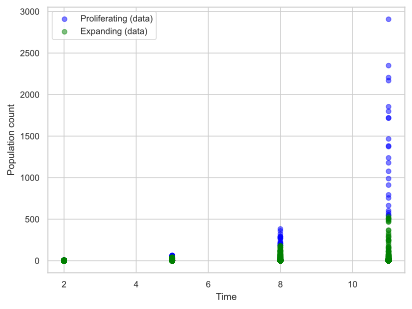

In [14]:
# Plot the experimental data
plt.scatter(df['Day'][df['ProliferationID']==1], df['number_of_cells'][df['ProliferationID']==1], label='Proliferating (data)', color='blue', marker='o', alpha=0.5)
plt.scatter(df['Day'][df['ProliferationID']==0], df['number_of_cells'][df['ProliferationID']==0], label='Expanding (data)', color='green', marker='o', alpha=0.5)

# Add labels and legend
plt.xlabel('Time')
plt.ylabel('Population count')
plt.legend()

# Show the plot
plt.show()

# Data 2

In [205]:
#put your path here
Days = ("Day2","Day4","Day6","Day8","Day10")
Days_n = [2,4,6,8,10]
path_to_experiment = '/Volumes/4TDATA_RAR/RAR/Shaffer_Scope/RAR023/'
path_to_table = "/Tables/"

# Get all FinalTable... .txt files for each day 
final_paths = [path_to_experiment + s + path_to_table for s in Days]

print("Reading files:")

df = pd.DataFrame()
cnt = 0
for i in final_paths:
    
    print("               Day " + Days[cnt])
    #Get all mask files
    all_txt_files = list(filter(lambda x: x.startswith('FinalTable'), os.listdir(i)))
    all_txt_files = sorted(all_txt_files)
    cnt += 1 
    
    for j in range(0,len(all_txt_files)): 
        
        df_hold = pd.read_csv(i + all_txt_files[j], sep=",")
        df_hold['well_ID'] = j+1
        df_hold['Day'] = Days_n[cnt-1]
        df = pd.concat([df,df_hold])

    print('                            Read ' + str(len(all_txt_files)) + ' files!')
    
# Calculate any metric you want on the dataframe
df['Colony_area_per_number_of_cells'] = df.Colony_area/df.number_of_cells
df = df.sort_values(by=["Day"])


Reading files:
               Day Day2
                            Read 12 files!
               Day Day4
                            Read 8 files!
               Day Day6
                            Read 11 files!
               Day Day8
                            Read 9 files!
               Day Day10
                            Read 11 files!


In [38]:
# Add expanding and committed ID
df['ProliferationID'] = [0]*len(df["Day"])
for day in np.unique(df["Day"]):
    logic_d = df['number_of_cells'] > df[df["Day"] == day].quantile(.87)['number_of_cells']
    logic_d[df["Day"] != day] = False
    
    HOLD = df['ProliferationID']
    
    HOLD[logic_d] = 1

    df['ProliferationID'] = HOLD



/var/folders/hs/3dbj5ws97_z0vv2zh1fbrjj40000gr/T/ipykernel_71098/2963073316.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  HOLD[logic_d] = 1
/var/folders/hs/3dbj5ws97_z0vv2zh1fbrjj40000gr/T/ipykernel_71098/2963073316.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  HOLD[logic_d] = 1
/var/folders/hs/3dbj5ws97_z0vv2zh1fbrjj40000gr/T/ipykernel_71098/2963073316.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  HOLD[logic_d] = 1
/

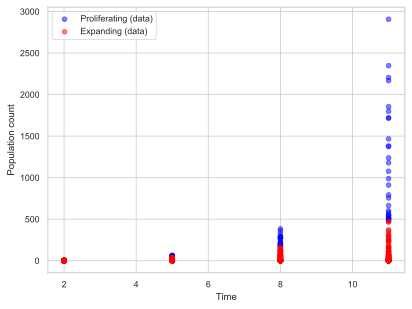

In [39]:
# Plot the experimental data
plt.scatter(df['Day'][df['ProliferationID']==1], df['number_of_cells'][df['ProliferationID']==1], label='Proliferating (data)', color='blue', marker='o', alpha=0.5)
plt.scatter(df['Day'][df['ProliferationID']==0], df['number_of_cells'][df['ProliferationID']==0], label='Expanding (data)', color='red', marker='o', alpha=0.5)

# Add labels and legend
plt.xlabel('Time')
plt.ylabel('Population count')
plt.legend()

# Show the plot
plt.show()

# Fit data

One common approach is to minimize the sum of squared differences between the model predictions and the experimental data. This is known as least-squares fitting. You can use the scipy.optimize package to perform this optimization.

Here's an outline of the steps to perform the fitting:

    Define a cost function that computes the sum of squared differences between the model predictions and the experimental data for a given set of parameters.
    Use an optimization algorithm, like scipy.optimize.minimize, to find the parameter values that minimize the cost function.
    Evaluate the goodness of fit using statistical measures, like the coefficient of determination (R-squared) or the root-mean-square error (RMSE).

Best-fit parameters:
k1: 0.15392815873317375
Growth rate: 0.5468110491532072


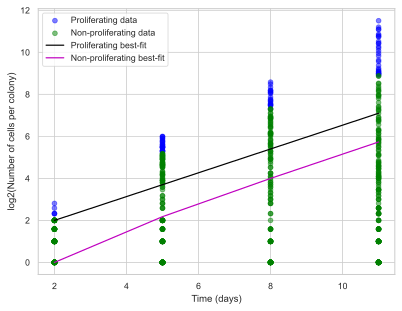

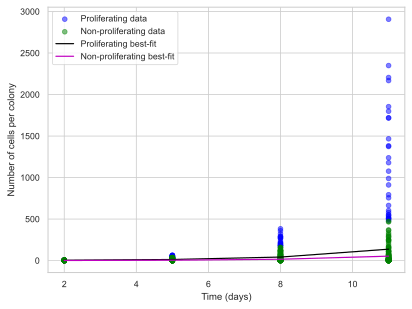

In [41]:
#synthetic_data = np.array(synthetic_data, dtype=[('population', 'float64'), ('label', 'U15')])

#Now, the synthetic data will have population sizes and labels 
#('Proliferating' or 'Non-proliferating') for each measurement.
#The largest 10% of the colonies each day are labeled as proliferating.

#To fit the model considering the labels, you can create separate arrays 
#for the proliferating and non-proliferating populations:

prolif_data = [ i for i in df['number_of_cells'][df['ProliferationID']==1] ] 

non_prolif_data = [ i for i in df['number_of_cells'][df['ProliferationID']==0] ] 

synthetic_data_combined = np.array(df['number_of_cells'])
t_synthetic_repeated = np.array(df["Day"])

# Initial conditions
y0 = [1, 1]  # Initial number of proliferating and non-proliferating cells

# Time vector
t = np.linspace(0, 10, 100)  # Time points from 0 to 100 with 100 points


# Define the ODE model
def two_state_system(y, t, k1, growth_rate):
    proliferating, non_proliferating = y
    
    dydt = [
        growth_rate * proliferating - k1 * proliferating ,  # Change in proliferating cells
        k1 * proliferating   # Change in non-proliferating cells
    ]
    return dydt


def cost_function_combined(params, t, combined_data):
    k1, growth_rate = params
    solution = odeint(two_state_system, y0, t, args=(k1, growth_rate))

    # Combine the model's populations into a single population
    combined_solution = np.sum(solution, axis=1)

    # Calculate the sum of squared differences
    ssd = np.sum((combined_solution - combined_data) ** 2)
    return ssd

# Initial conditions
y0 = [4, 1]  # Initial number of proliferating and non-proliferating cells

# Initial parameter values
initial_params = [0.2, 0.7]  # Initial values for k1, and growth_rate


# Optimize the parameters
result = minimize(cost_function_combined, initial_params, args=(t_synthetic_repeated, synthetic_data_combined), method='L-BFGS-B', bounds=[(0, None), (0, None)])

# Extract the best-fit parameters
k1_best, growth_rate_best = result.x


# Generate the best-fit solution
solution_best_fit = odeint(two_state_system, y0, t_synthetic_repeated, args=(k1_best, growth_rate_best))

# # Evaluate the goodness of fit using the R-squared value
# ssd_best_fit = np.sum((solution_best_fit - experimental_data) ** 2)
# sst = np.sum((experimental_data - np.mean(experimental_data, axis=0)) ** 2)
# r_squared = 1 - (ssd_best_fit / sst)

print("Best-fit parameters:")
print("k1:", k1_best)
print("Growth rate:", growth_rate_best)
#print("R-squared:", r_squared)

# Get the time points corresponding to proliferating and non-proliferating data
prolif_time_points = df['Day'][df['ProliferationID']==1] 
non_prolif_time_points = df['Day'][df['ProliferationID']==0] 

plt.figure()
# Plot the experimental data
plt.scatter(prolif_time_points, np.log2(prolif_data), label='Proliferating data', c='b', marker='o', alpha=0.5)
plt.scatter(non_prolif_time_points, np.log2(non_prolif_data), label='Non-proliferating data', c='g', marker='o', alpha=0.5)

# Plot the best-fit model
plt.plot(t_synthetic_repeated, np.log2(solution_best_fit[:, 0]), label='Proliferating best-fit', c='k', linestyle='-')
plt.plot(t_synthetic_repeated, np.log2(solution_best_fit[:, 1]), label='Non-proliferating best-fit', c='m', linestyle='-')


plt.xlabel('Time (days)')
plt.ylabel('log2(Number of cells per colony)')
plt.legend()
plt.show()


plt.figure()
# Plot the experimental data
plt.scatter(prolif_time_points, prolif_data, label='Proliferating data', c='b', marker='o', alpha=0.5)
plt.scatter(non_prolif_time_points, non_prolif_data, label='Non-proliferating data', c='g', marker='o', alpha=0.5)

# Plot the best-fit model
plt.plot(t_synthetic_repeated, solution_best_fit[:, 0], label='Proliferating best-fit', c='k', linestyle='-')
plt.plot(t_synthetic_repeated, solution_best_fit[:, 1], label='Non-proliferating best-fit', c='m', linestyle='-')


plt.xlabel('Time (days)')
plt.ylabel('Number of cells per colony')
plt.legend()
plt.show()

In [42]:
synthetic_data_combined = np.array(df['number_of_cells'])
t_synthetic_repeated = np.array(df["Day"])


# synthetic_data_combined = np.array([ i for i in df['number_of_cells'][df['ProliferationID']==1] ]) 
# t_synthetic_repeated= np.array([ i for i in df['Day'][df['ProliferationID']==1] ] )


# synthetic_data_combined =np.array([ i for i in df['number_of_cells'][df['ProliferationID']==0] ] )
# t_synthetic_repeated= np.array([ i for i in df['Day'][df['ProliferationID']==0] ] )



Best-fit parameters:
k1: 0.15392815873317375
Growth rate: 0.5468110491532072


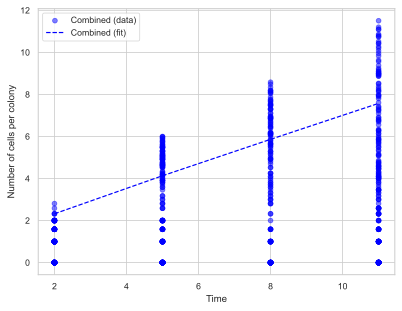

In [43]:
# Define the ODE model
def two_state_system(y, t, k1, growth_rate):
    proliferating, non_proliferating = y
    
    dydt = [
        growth_rate * proliferating - k1 * proliferating ,  # Change in proliferating cells
        k1 * proliferating   # Change in non-proliferating cells
    ]
    return dydt


def cost_function_combined(params, t, combined_data):
    k1, growth_rate = params
    solution = odeint(two_state_system, y0, t, args=(k1, growth_rate))

    # Combine the model's populations into a single population
    combined_solution = np.sum(solution, axis=1)

    # Calculate the sum of squared differences
    ssd = np.sum((combined_solution - combined_data) ** 2)
    return ssd


# Optimize the parameters
result = minimize(cost_function_combined, initial_params, args=(t_synthetic_repeated, synthetic_data_combined), method='L-BFGS-B', bounds=[(0, None), (0, None)])

# Extract the best-fit parameters
k1_best, growth_rate_best = result.x

# Evaluate the goodness of fit using the R-squared value
# solution_best_fit = odeint(two_state_system, y0, t, args=(k1_best, k2_best, growth_rate_best))
# ssd_best_fit = np.sum((solution_best_fit - experimental_data) ** 2)
# sst = np.sum((experimental_data - np.mean(experimental_data, axis=0)) ** 2)
# r_squared = 1 - (ssd_best_fit / sst)


print("Best-fit parameters:")
print("k1:", k1_best)
print("Growth rate:", growth_rate_best)
# print("R-squared:", r_squared)

# Generate the best-fit solution
solution_best_fit = odeint(two_state_system, y0, t_synthetic_repeated, args=(k1_best, growth_rate_best))
combined_solution_best_fit = np.sum(solution_best_fit, axis=1)

# Plot the experimental data
plt.scatter(t_synthetic_repeated, np.log2(synthetic_data_combined), label='Combined (data)', color='blue', marker='o', alpha=0.5)

# Plot the best-fit model predictions
plt.plot(t_synthetic_repeated, np.log2(combined_solution_best_fit), label='Combined (fit)', color='blue', linestyle='--')

# Add labels and legend
plt.xlabel('Time')
plt.ylabel('Number of cells per colony')
plt.legend()

# Show the plot
plt.show()




# Gillespie

### Model

Correct order for stoichiometry matrix:

$${E \xrightarrow{ge} E + E \qquad E  \xrightarrow{keh} H   }$$


In [44]:
osc_N = np.array([[1,-1],  #E
                  [0, 1]]) #H

def osc_V_yc(y,ge,keh):
    return np.array([ge*y[0], keh*y[0]])

In [45]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
import random
import numpy as np
import pandas as pd
import seaborn as sb

def Gillespie(N, V, y0, tlen):
#   N is the stoichiometry matrix
#   rate function V. function that gives us the propensities as a function of the current state.  
#     V is the k reactivities or the equiibrium associations. Note V(y) gives the matrix we are looking for when starting the beginning of the algorithm.
#   y0 is the initial condition/state vector.
#   tlen is max length of time. We will build up to this.
  
    t = 0.0 #starting time
    ts = [0.0]  #reporting array, to save information
    y = np.copy(y0) #using the given initial condition
    res = [list(y)]  #lists because these will be dynamically resizing bcs we will be randomly choosing our time intervals. We could pre-allocate these in a np.array to make more efficient. 

    while True: #just continuously looping until there is a break from within
        prop = V(y) #propensities
        a0 = sum(prop) #to see total propensity
        if a0 == 0:
            break
        dt = random.expovariate(a0) #same thing as dt = np.random.exponential(1.0/a0)


        if t + dt > tlen: #if waiting time will exceed time limit
            break

        #picking with reaction to do 
        idx = random.choices(population=range(len(prop)),  #population is the indexes of these propensities
                             weights = prop,   #propensities
                             k=1) #we only want one value to be picked because every time we execute a reaction, the propensities change

        #Pulling out the columns from the stoich matrix for all the specifes with respect to that reaction
        change_to_apply = N[:,idx] #idx applied to the state vector
        #need to re shape because it comes out as a 2D array
        change_to_apply.shape = len(change_to_apply) #converting to 1D array

        #Adding the time
        t += dt
        #How the state is going to change
        y+= change_to_apply #this is a np.array

        #saving the time and results so that we can use it later
        ts.append(t)
        res.append(list(y))
        
    return(ts, np.array(res))


In [46]:
def plot_Gillespie(osc_N,osc_V,y0,times,runs):
    # initialize list
    plot_tf = []
    plot_Ef = []
    plot_Hf = []
    plot_all = []
    
    for t in times:
        tlen = t
        plt.figure()
        for i in range(0,runs):

            (ts, res) = Gillespie(osc_N, osc_V, y0, tlen)

            #if abs(ts[-1] - 1)>3:
            plot_tf.append(ts[-1])
            plot_Ef.append(res[:,0][-1])
            plot_Hf.append(res[:,1][-1])
            plot_all.append(res[:,0][-1] + res[:,1][-1])
            
            plt.plot(ts, res[:,0],'g-', alpha=0.2)
            plt.plot(ts, res[:,1],'r-', alpha=0.2)
     
    plt.xlabel('Time')
    plt.ylabel('Number of cells per colony')
    titleStr = '#E0='+str(y0[0])+', #H0='+str(y0[1])
    plt.title(titleStr)  
    e = np.linspace(0,max(times),100)
    plt.plot(e,2**e,'k--')
    plt.legend(['E','H','Exponential'])
    plt.xlim([min(times),max(times)])
    plt.show()
    
    return [plot_tf,plot_Ef,plot_Hf,plot_all]


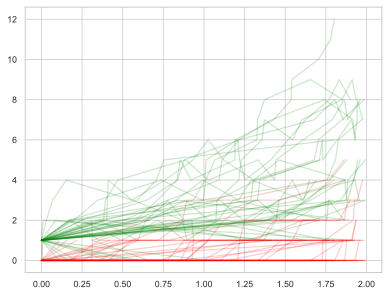

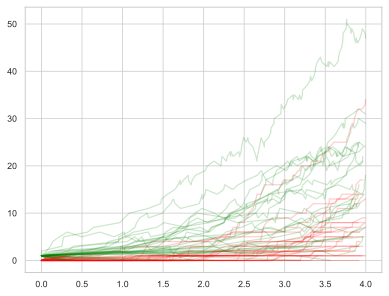

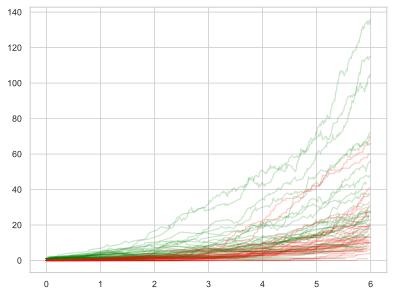

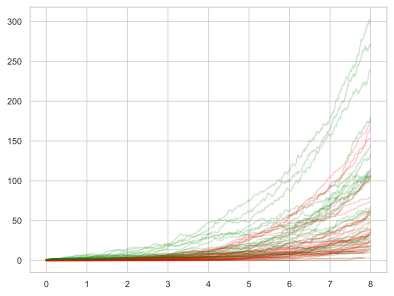

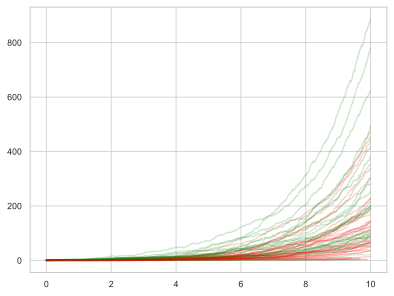

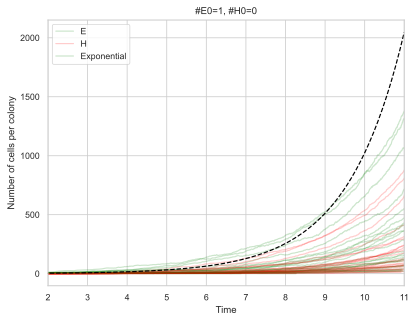

In [59]:
# variables
y0 = np.array([1,0]) #Start population size
times = [2,4,6,8,10,11]
runs = 50


# Division rates
ge = .8

# Diferentiation rates
keh = .3

osc_V = lambda y: osc_V_yc(y,ge,keh)


[plot_tf,plot_Ef,plot_Hf,plot_all] = plot_Gillespie(osc_N,osc_V,y0,times,runs)




In [49]:
def value_Gillespie(osc_N,osc_V,y0,times,runs):
    # initialize list
    plot_tf = []
    plot_Ef = []
    plot_Hf = []
    plot_all = []
    
    for t in times:
        tlen = t
        for i in range(0,runs):

            (ts, res) = Gillespie(osc_N, osc_V, y0, tlen)

            #if abs(ts[-1] - 1)>3:
            plot_tf.append(ts[-1])
            plot_Ef.append(res[:,0][-1])
            plot_Hf.append(res[:,1][-1])
            plot_all.append(res[:,0][-1] + res[:,1][-1])
            
    return [plot_tf,plot_Ef,plot_Hf,plot_all]


In [68]:
from scipy.stats import ks_2samp, anderson_ksamp
from scipy.special import kl_div
from scipy.stats import wasserstein_distance
from sklearn.utils import resample
test_growth = np.array(df['number_of_cells'])

#test_growth = test_growth[test_growth>1]


# how corse or fine
step = 100
runs = len(test_growth)

# Diferentiation rates
keh = np.linspace(0.0,10,step)

# Transition rates
ge = np.linspace(0.0,0.3,step)


# Arrays
Heat_total = np.zeros((step, step))
Heat_Ef = np.zeros((step, step))
Heat_Hf = np.zeros((step, step))

Heat_Kolmogorov = np.zeros((step, step))
Heat_Anderson = np.zeros((step, step))
Heat_Kullback = np.zeros((step, step)) 
Heat_Wasserstein = np.zeros((step, step))
Heat_Boot = np.zeros((step, step))

Heat_Kolmogorov_p = np.zeros((step, step))
Heat_Anderson_p = np.zeros((step, step))


for i in range(0,step):

    for ii in range(0,step):
        
        osc_V = lambda y: osc_V_yc(y,ge[ii],keh[i])

        [plot_tf,plot_Ef,plot_Hf,plot_all] = value_Gillespie(osc_N,osc_V,y0,times,runs)
        Heat_total[i][ii] = np.mean(plot_all[-runs-1:-1])
        Heat_Ef[i][ii] = np.mean(plot_Ef[-runs-1:-1])
        Heat_Hf[i][ii] = np.mean(plot_Hf[-runs-1:-1])
        
        simulated_growth = plot_all[-runs-1:-1]
        
        # 3. Kolmogorov-Smirnov test
        ks_stat, ks_p_value = ks_2samp(simulated_growth, test_growth)
        Heat_Kolmogorov[i][ii] = ks_stat 
        Heat_Kolmogorov_p[i][ii] = ks_p_value

        # 4. Anderson-Darling test
        ad_stat, ad_critical_values, ad_significance_level = anderson_ksamp([simulated_growth, test_growth])
        Heat_Anderson[i][ii] = ad_stat
        Heat_Anderson_p[i][ii] = ad_significance_level


        # Define the histogram parameters
        num_bins = 50
        min_value = min(np.min(simulated_growth), np.min(test_growth))
        max_value = max(np.max(simulated_growth), np.max(test_growth))

        # Compute histograms
        hist_simulated, _ = np.histogram(simulated_growth, bins=num_bins, range=(min_value, max_value))
        hist_test, _ = np.histogram(test_growth, bins=num_bins, range=(min_value, max_value))

        # Convert histograms to probability distributions
        simulated_growth_dist = hist_simulated / np.sum(hist_simulated)
        test_growth_dist = hist_test / np.sum(hist_test)

        # Avoid division by zero errors by adding a small constant
        epsilon = 1e-10
        simulated_growth_dist += epsilon
        test_growth_dist += epsilon

        # 5. Kullback-Leibler divergence
        kl_divergence = np.sum(kl_div(simulated_growth_dist, test_growth_dist))
        Heat_Kullback[i][ii] = kl_divergence 
        
        # 6. Earth Mover's Distance (Wasserstein distance)
        emd = wasserstein_distance(simulated_growth, test_growth)
        Heat_Wasserstein[i][ii] = emd
        
        # 7. Bootstrap hypothesis testing
        n_iterations = 1000
        diff_means = []

        for _ in range(n_iterations):
            # Resample the data with replacement
            resampled_simulated = resample(simulated_growth)
            resampled_test = resample(test_growth)

            # Compute the difference in means
            diff_means.append(np.mean(resampled_simulated) - np.mean(resampled_test))

        # Estimate the p-value
        p_value_bootstrap = np.sum(np.array(diff_means) > 0) / n_iterations
        if p_value_bootstrap == 0:
            p_value_bootstrap == .0001
        Heat_Boot[i][ii] = p_value_bootstrap 


        
print('Done :)')

/var/folders/hs/3dbj5ws97_z0vv2zh1fbrjj40000gr/T/ipykernel_71098/3771362045.py:55: UserWarning: p-value floored: true value smaller than 0.001
  ad_stat, ad_critical_values, ad_significance_level = anderson_ksamp([simulated_growth, test_growth])


Done :)


<Figure size 640x480 with 0 Axes>

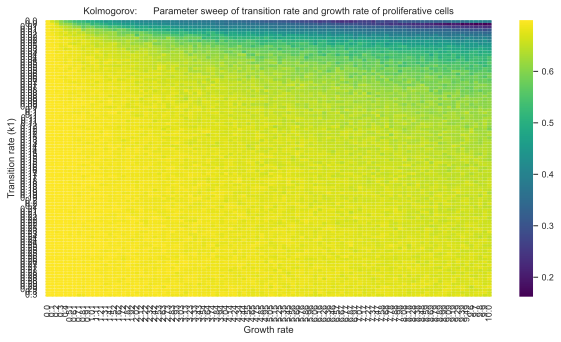

<Figure size 640x480 with 0 Axes>

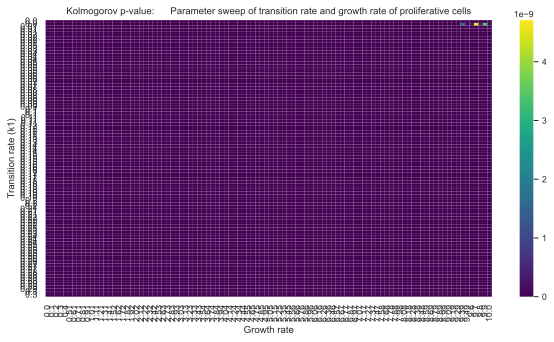

<Figure size 640x480 with 0 Axes>

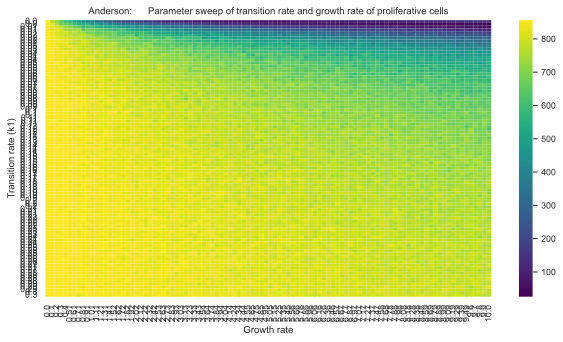

<Figure size 640x480 with 0 Axes>

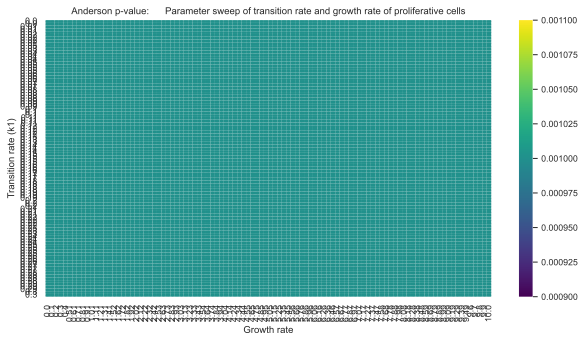

<Figure size 640x480 with 0 Axes>

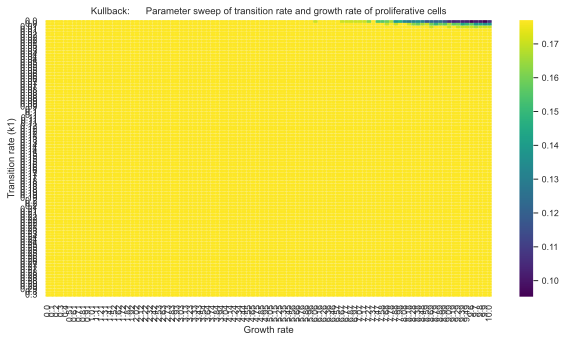

<Figure size 640x480 with 0 Axes>

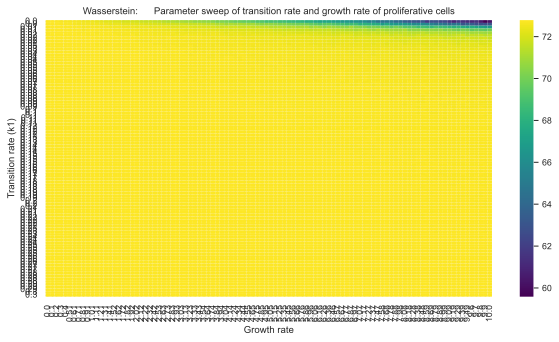

<Figure size 640x480 with 0 Axes>

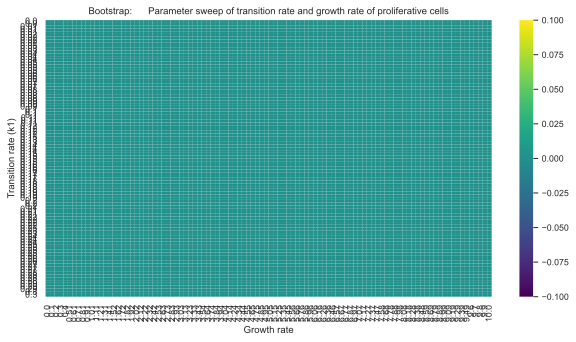

In [69]:


names_of_methods = ['Kolmogorov','Kolmogorov p-value'  ,'Anderson' ,'Anderson p-value' ,'Kullback' ,'Wasserstein' ,'Bootstrap']
for n,i in enumerate([Heat_Kolmogorov,Heat_Kolmogorov_p  ,Heat_Anderson ,Heat_Anderson_p ,Heat_Kullback ,Heat_Wasserstein ,Heat_Boot]):
    plt.figure()
    # Plot the results as a heatmap
    plt.figure(figsize=(10, 5))
    sns.heatmap(i, cmap='viridis', xticklabels=np.round(keh, 2),
                yticklabels=np.round(ge, 2))
    plt.xlabel('Growth rate')
    plt.ylabel('Transition rate (k1)')
    plt.title(names_of_methods[n]+':      Parameter sweep of transition rate and growth rate of proliferative cells')
    plt.show()



In [489]:
!pip install scikit-learn

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.0/9.0 MB 17.8 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 298.0/298.0 kB 26.2 MB/s eta 0:00:00
  Using cached threadpoolctl-3.1.0-py3-none-any.whl (14 kB)


In [617]:
    plt.figure()
    # Plot the results as a heatmap
    plt.figure(figsize=(10, 5))
    sns.heatmap(Heat_total, cmap='viridis', xticklabels=np.round(keh, 2),
                yticklabels=np.round(ge, 2))
    plt.xlabel('Growth rate')
    plt.ylabel('Transition rate (k1)')
    plt.title(names_of_methods[n]+':      Parameter sweep of transition rate and growth rate of proliferative cells')
    plt.show()



TypeError: object of type 'numpy.float64' has no len()

<Figure size 640x480 with 0 Axes>

<Figure size 1000x500 with 0 Axes>

In [618]:
Heat_total

array([[  1.        ,   1.32408236,   1.68307968,   2.2256043 ,
          2.85854969,   3.69919427,   5.04565801,   6.49059982,
          7.65801253,  10.86929275,  13.67502238,  18.86660698,
         23.1915846 ,  30.30886303,  38.50940018,  51.67233662,
         69.19427037,  87.56222023, 110.52014324, 146.14145031],
       [  1.        ,   1.05550582,   1.11101164,   1.1656222 ,
          1.24798568,   1.32945389,   1.42166517,   1.52193375,
          1.6606983 ,   1.86839749,   1.98657117,   2.1038496 ,
          2.31154879,   2.50940018,   2.77976723,   3.0698299 ,
          3.52282901,   4.28200537,   4.60161146,   5.23455685],
       [  1.        ,   1.02059087,   1.05282005,   1.08057296,
          1.10922113,   1.1396598 ,   1.17457475,   1.20590868,
          1.27573859,   1.31065354,   1.35004476,   1.39301701,
          1.42435094,   1.47627574,   1.48433303,   1.58549687,
          1.67144136,   1.7305282 ,   1.75022381,   1.90868397],
       [  1.        ,   1.01342883,  